In [1]:
# import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import matplotlib.pyplot as plt
import xlrd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import MinMaxScaler

from sklearn.datasets import make_regression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.datasets import make_classification
from sklearn import datasets, linear_model
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import LabelEncoder


### Data Cleaning and Data preprocessing

In [2]:
#import the data
df = pd.read_excel("C:/Users/elon6/Downloads/merged_df (2).xlsx")

In [3]:
df

,driver_id,key,car_group,total_km,km_road,km_ofroad,total_eng_time,eng_time_standing,eng_time_standing_precent,saftey_grade,Fuel_economy_grade,braking,turns,lane_crossing,Speed_?deviations,acceleration,Special_evants,fault
0,2211933,298469,87.0,139.3,139.0,0.3,02:31:05,0:14,9.00%,100,91,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,6068860,NaN,NaN,3895.8,3767.6,128.2,139:03:33,59:42,43.00%,97,57,21.0,11.0,NaN,NaN,2.0,NaN,NaN
2,8263549,298920,81.0,0.9,0.9,0.0,00:30:37,0:24,78.00%,0,22,NaN,2.0,NaN,NaN,NaN,NaN,NaN
3,4680246,NaN,NaN,312.1,311.0,1.1,07:14:28,1:03,15.00%,94,85,2.0,3.0,NaN,NaN,NaN,NaN,NaN
4,8450000,298851,81.0,62.9,62.9,0.0,01:19:06,0:03,4.00%,78,96,1.0,3.0,NaN,NaN,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6819,9675662,NaN,NaN,2316.3,2211.4,104.9,65:32:20,12:12,19.00%,91,81,20.0,24.0,NaN,NaN,5.0,NaN,NaN
6820,8700935,NaN,NaN,7654.8,7143.5,511.3,251:30:56,81:14,32.00%,73,67,141.0,400.0,113.0,5.0,100.0,2.0,NaN
6821,9153106,NaN,NaN,2056.9,2031.9,25.0,52:39:59,4:59,9.00%,95,90,6.0,NaN,NaN,NaN,15.0,NaN,NaN
6822,7063055,NaN,NaN,121.2,119.5,1.7,02:29:54,0:05,3.00%,100,97,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
#change the time from H/M/S to hours
def convert_to_hours(time_str):
    hours, minutes, seconds = map(int, time_str.split(':'))
    total_hours = hours + (minutes / 60) + (seconds / 3600)
    return total_hours

df['total_eng_time'] = df['total_eng_time'].apply(convert_to_hours)


In [5]:
df.drop(['key'], axis=1, inplace=True)

creat now coulmn for our y vierable. <br>
acci_fault - represents whether the driver had an accident at fault, 1 - yes, 0 - no <br>
acci - represents whether the driver had an accident even if it was not his fault,1 - yes 0 - no

In [6]:
#acci_fault
df['acci_fault']= df['fault']
df['acci_fault']= df['acci_fault'].replace(np.nan,0)

#acci
df['acci']= df['fault']
df['acci']= df['acci'].replace(0,1)
df['acci']= df['acci'].replace(np.nan,0)


In [7]:
#removing null values
df['fault']= df['fault'].replace(np.nan,0)
df['car_group']= df['car_group'].replace(np.nan,100)
df['braking']= df['braking'].replace(np.nan,0)
df['turns']= df['turns'].replace(np.nan,0)
df['lane_crossing']= df['lane_crossing'].replace(np.nan,0)
df['Speed_?deviations']= df['Speed_?deviations'].replace(np.nan,0)
df['acceleration']= df['acceleration'].replace(np.nan,0)
df['Special_evants']= df['Special_evants'].replace(np.nan,0)

In [8]:
df.drop(['eng_time_standing'], axis=1, inplace=True)

In [9]:
#chaning the column to repesent %
df['eng_time_standing_precent'] = df['eng_time_standing_precent'].str.rstrip('%').astype(float)


In [10]:
df

,driver_id,car_group,total_km,km_road,km_ofroad,total_eng_time,eng_time_standing_precent,saftey_grade,Fuel_economy_grade,braking,turns,lane_crossing,Speed_?deviations,acceleration,Special_evants,fault,acci_fault,acci
0,2211933,87.0,139.3,139.0,0.3,2.518056,9.0,100,91,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,6068860,100.0,3895.8,3767.6,128.2,139.059167,43.0,97,57,21.0,11.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0
2,8263549,81.0,0.9,0.9,0.0,0.510278,78.0,0,22,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4680246,100.0,312.1,311.0,1.1,7.241111,15.0,94,85,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,8450000,81.0,62.9,62.9,0.0,1.318333,4.0,78,96,1.0,3.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6819,9675662,100.0,2316.3,2211.4,104.9,65.538889,19.0,91,81,20.0,24.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0
6820,8700935,100.0,7654.8,7143.5,511.3,251.515556,32.0,73,67,141.0,400.0,113.0,5.0,100.0,2.0,0.0,0.0,0.0
6821,9153106,100.0,2056.9,2031.9,25.0,52.666389,9.0,95,90,6.0,0.0,0.0,0.0,15.0,0.0,0.0,0.0,0.0
6822,7063055,100.0,121.2,119.5,1.7,2.498333,3.0,100,97,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
#Outliers
df_km = df[df["total_km"]>72]
df_km = df_km[df_km["km_road"]>0]
df_km = df_km[df_km["driver_id"]!=-1]

creating columns the will repesent the number of abnormal driving events per 100 KM

In [12]:
df_km['braking_km'] = (df_km['braking']/df_km['km_road'])*100
df_km['turns_km'] = (df_km['turns']/df_km['km_road'])*100
df_km['lane_crossing_km'] = (df_km['lane_crossing']/df_km['km_road'])*100
df_km['Speed_?deviations_km'] = (df_km['Speed_?deviations']/df_km['km_road'])*100
df_km['acceleration_km'] = (df_km['acceleration']/df_km['km_road'])*100
df_km['Special_evants_km'] = (df_km['Special_evants']/df_km['km_road'])*100
df_km['eng_rate'] = df_km['total_km']/df['total_eng_time']

In [13]:
df_km.drop(['braking'], axis=1, inplace=True)
df_km.drop(['Speed_?deviations'], axis=1, inplace=True)
df_km.drop(['acceleration'], axis=1, inplace=True)
df_km.drop(['Special_evants'], axis=1, inplace=True)
df_km.drop(['lane_crossing'], axis=1, inplace=True)
df_km.drop(['turns'], axis=1, inplace=True)


In [14]:
#avr of the abnormal driving events per 100 KM
df_km['grade'] = (df_km['braking_km'] + df_km['turns_km'] + df_km['lane_crossing_km'] + df_km['Speed_?deviations_km'] + df_km['acceleration_km'] + df_km['Special_evants_km'])/6

In [15]:
df_km

,driver_id,car_group,total_km,km_road,km_ofroad,total_eng_time,eng_time_standing_precent,saftey_grade,Fuel_economy_grade,fault,acci_fault,acci,braking_km,turns_km,lane_crossing_km,Speed_?deviations_km,acceleration_km,Special_evants_km,eng_rate,grade
0,2211933,87.0,139.3,139.0,0.3,2.518056,9.0,100,91,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.320463,0.000000
1,6068860,100.0,3895.8,3767.6,128.2,139.059167,43.0,97,57,0.0,0.0,0.0,0.557384,0.291963,0.000000,0.000000,0.053084,0.000000,28.015413,0.150405
3,4680246,100.0,312.1,311.0,1.1,7.241111,15.0,94,85,0.0,0.0,0.0,0.643087,0.964630,0.000000,0.000000,0.000000,0.000000,43.101120,0.267953
6,8229043,100.0,1919.0,1861.2,57.8,76.918056,52.0,91,48,0.0,0.0,0.0,0.483559,0.537288,0.000000,0.000000,0.591017,0.000000,24.948629,0.268644
8,8234402,87.0,103.5,94.5,9.0,3.858889,40.0,97,60,0.0,0.0,0.0,0.000000,1.058201,0.000000,0.000000,0.000000,0.000000,26.821192,0.176367
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6818,9177298,100.0,6883.7,5340.0,1543.7,277.283333,32.0,89,67,0.0,0.0,0.0,0.880150,1.554307,0.112360,0.000000,0.917603,0.000000,24.825509,0.577403
6819,9675662,100.0,2316.3,2211.4,104.9,65.538889,19.0,91,81,0.0,0.0,0.0,0.904404,1.085285,0.000000,0.000000,0.226101,0.000000,35.342375,0.369298
6820,8700935,100.0,7654.8,7143.5,511.3,251.515556,32.0,73,67,0.0,0.0,0.0,1.973822,5.599496,1.581858,0.069994,1.399874,0.027997,30.434698,1.775507
6821,9153106,100.0,2056.9,2031.9,25.0,52.666389,9.0,95,90,0.0,0.0,0.0,0.295290,0.000000,0.000000,0.000000,0.738225,0.000000,39.055269,0.172253


In [16]:
from pandas_profiling import ProfileReport


C:\Users\elon6\AppData\Local\Temp\ipykernel_21060\3063248848.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


# overall report

In [17]:
profiler = ProfileReport(df_km)
profiler.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import TomekLinks
from imblearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline

# import models.
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.linear_model import RidgeClassifier
from sklearn.svm import SVC 
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier, OneVsOneClassifier

In [26]:
X = df_km.drop('acci', axis=1)
y = df_km['acci']

In [27]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [28]:

# Create a pipeline to perform SMOTE oversampling followed by Tomek Links undersampling
resampling = Pipeline([
    ('smote', SMOTE(sampling_strategy=0.7, random_state=42)),
    ('tomek', TomekLinks(sampling_strategy='majority'))
])


In [29]:
# Apply the resampling
X_resampled, y_resampled = resampling.fit_resample(X_train, y_train)

In [44]:
# creating the pipline for running the different models.
piplines = {
    'decisiontreeclassifier':make_pipeline(DecisionTreeClassifier()),
    'ovo_logistic':make_pipeline(OneVsOneClassifier(LogisticRegression(solver='sag', random_state=1234))),
    'svc':make_pipeline(SVC()),
    'rf':make_pipeline(RandomForestClassifier(random_state=1234)),

}

In [45]:
hypergrid = {
    'rf':{
        'randomforestclassifier__n_estimators':[10,50,100,130],
        'randomforestclassifier__criterion':['gini', 'entropy'],
        'randomforestclassifier__max_depth':range(2,4,1),
        'randomforestclassifier__min_samples_split':[2,3,4,5,6],
        'randomforestclassifier__min_samples_leaf':[1,2,3,4,5,6],
        'randomforestclassifier__max_features':['auto', 'log2']
    },
    'decisiontreeclassifier':{
        'decisiontreeclassifier__max_depth': [2,4,6,8],
        'decisiontreeclassifier__min_samples_split': [2,4,6,8]
    },
    'ovo_logistic':{  
    },
    'svc':{
        'svc__gamma':['scale', 'auto']
    }
}

In [47]:
from sklearn.model_selection import GridSearchCV

fit_models = {}
scores = []

for algo, pipeline in piplines.items():
    if algo not in ['xgb', 'ridge']:  # Exclude 'xgb' and 'ridge' algorithms
        print(pipeline)
        print(hypergrid[algo])
        model = GridSearchCV(pipeline, hypergrid[algo], cv=10, n_jobs=-1)

        try:
            print("Starting training for {}".format(algo))
            model.fit(X_train, y_train)
            fit_models[algo] = model
            print("{} trained successfully!".format(algo))
            scores.append({
                'model_name': algo,
                'best_score': model.best_score_,  # average f1-score for each model in the cross-validation
                'best_params': model.best_params_
            })
        except NotFittedError as e:
            print(repr(e))
        except Exception as e:
            print(e)
            print(repr(e))

Pipeline(steps=[('decisiontreeclassifier', DecisionTreeClassifier())])
{'decisiontreeclassifier__max_depth': [2, 4, 6, 8], 'decisiontreeclassifier__min_samples_split': [2, 4, 6, 8]}
Starting training for decisiontreeclassifier
decisiontreeclassifier trained successfully!
Pipeline(steps=[('onevsoneclassifier',
                 OneVsOneClassifier(estimator=LogisticRegression(random_state=1234,
                                                                 solver='sag')))])
{}
Starting training for ovo_logistic
ovo_logistic trained successfully!
Pipeline(steps=[('svc', SVC())])
{'svc__gamma': ['scale', 'auto']}
Starting training for svc
svc trained successfully!
Pipeline(steps=[('randomforestclassifier',
                 RandomForestClassifier(random_state=1234))])
{'randomforestclassifier__n_estimators': [10, 50, 100, 130], 'randomforestclassifier__criterion': ['gini', 'entropy'], 'randomforestclassifier__max_depth': range(2, 4), 'randomforestclassifier__min_samples_split': [2, 3, 4, 5

In [48]:
data_models = pd.DataFrame(scores)
data_models[['model_name','best_score']].sort_values(['best_score'],ascending=False)

,model_name,best_score
0,decisiontreeclassifier,0.971937
3,rf,0.971937
1,ovo_logistic,0.949042
2,svc,0.949042


In [49]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, precision_recall_fscore_support, auc, roc_curve

In [50]:
# predicting and extracting:
# accuracy, recall, precision, f1-score, AUC
results=[]
for algo, model in fit_models.items():
    predictions = model.predict(X_test)
    results.append({
        'algo':algo,
        'yhat':predictions,
        'acc':accuracy_score(y_test, predictions),
        'conf_mat':confusion_matrix(y_test, predictions, labels=model.classes_),
        'prf_weighted':precision_recall_fscore_support(y_test, predictions, average='weighted'),
        'dis_classes':model.classes_
    })

C:\Users\elon6\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\elon6\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


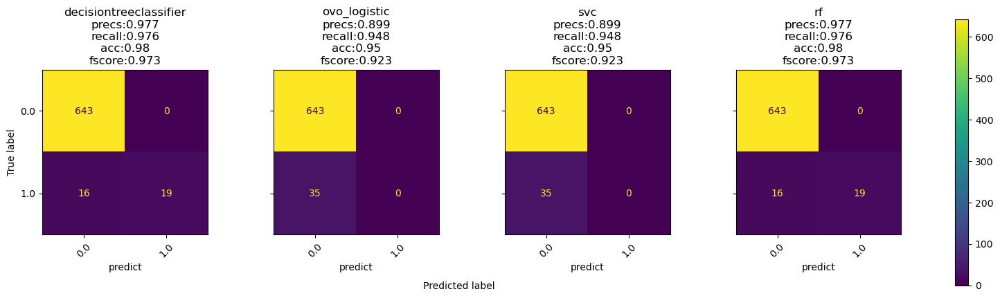

In [52]:
# visualizing the confusion matrix: 
f, axes = plt.subplots(1, 4, figsize=(20, 5), sharey='row')
for i, res in enumerate(results):
    algo, yhat, conf_mat, dis_classes=res['algo'], res['yhat'], res['conf_mat'],res['dis_classes']
    prec, recall, fscore = res['prf_weighted'][0],res['prf_weighted'][1],res['prf_weighted'][2]
    disp = ConfusionMatrixDisplay(confusion_matrix=conf_mat, display_labels=dis_classes)
    acc = res['acc']
    disp.plot(ax=axes[i], xticks_rotation=45)
    disp.ax_.set_title(f"{algo}\nprecs:{round(prec,3)}\nrecall:{round(recall,3)}\nacc:{round(acc,2)}\nfscore:{round(fscore,3)}" )
    
    disp.im_.colorbar.remove()
    disp.ax_.set_xlabel('predict')
    if i!=0:
        disp.ax_.set_ylabel('')


f.text(0.4, 0.1, 'Predicted label', ha='left')
plt.subplots_adjust(wspace=0.40, hspace=0.1)


f.colorbar(disp.im_, ax=axes)
plt.show()